# MG MidiAnalysis

In [1]:
import sys
sys.executable

'/home/cipher000/anaconda3/envs/MusicGenerator1/bin/python'

In [2]:
import pretty_midi
import pandas as pd
import numpy as np

import mir_eval.display
import librosa.display
from music21 import converter, instrument, note, chord, stream,graph, lily, corpus, environment, configure
import matplotlib.pyplot as plt
%matplotlib inline

from midi2audio import FluidSynth
import IPython.display as ipd

import os

In [3]:
import pretty_midi
import matplotlib.pyplot as plt
import librosa.display
import pandas as pd
import IPython.display as ipd

In [4]:
from music21 import *

env = environment.Environment()
env['musicxmlPath'] = '/usr/bin/musescore'
env['lilypondPath'] = '/usr/bin/lilypond'
env['musescoreDirectPNGPath'] = '/usr/bin/musescore'
env['pdfPath'] = '/usr/bin/lilypond'
env['graphicsPath'] = '/usr/bin/lilypond'

In [5]:
fs = 16000
rate = 16000
start_pitch = 24
end_pitch = 84

In [6]:
def plot_piano_roll(pm, start_pitch, end_pitch, fs=10):
    librosa.display.specshow(pm.get_piano_roll(fs)[start_pitch:end_pitch],
                             hop_length=1, sr=fs, x_axis='time', y_axis='cqt_note',
                             fmin=pretty_midi.note_number_to_hz(start_pitch))
    
def analyze_midi(midi_file):
    instrument_dict = {}
    pm = pretty_midi.PrettyMIDI(midi_file)
    plt.figure(figsize=(12, 6))
    plot_piano_roll(pm, start_pitch, end_pitch)
    print("Time Signature Changes: {} Instruments: {}".format(len(pm.time_signature_changes), len(pm.instruments)))
    for instrument_num in range(len(pm.instruments)):
        instrument_dict[instrument_num] = {'Notes': len(pm.instruments[instrument_num].notes), 
                                           'Pitch_Bends':len(pm.instruments[instrument_num].pitch_bends),
                                           'Control_Changes':len(pm.instruments[instrument_num].control_changes)}
    instrument_dict = pd.DataFrame(instrument_dict)
    return instrument_dict, pm

def convert_midi_to_notestream(midi_file):
    midi = converter.parse(midi_file)
    midi.show()

Time Signature Changes: 0 Instruments: 1


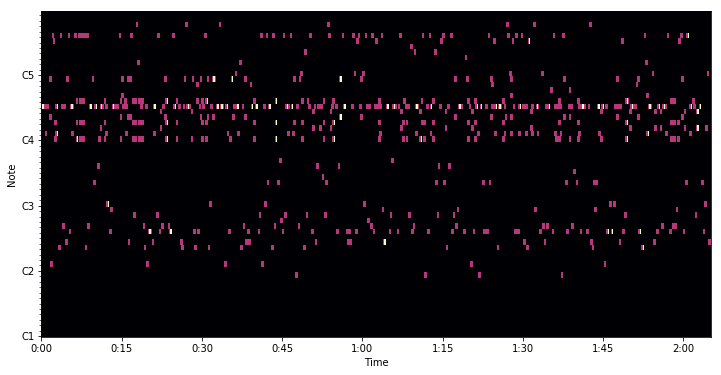

In [7]:
midi_file = '2_4L_201803290651-100-lstm_midi.mid'
instrument_dict,pm = analyze_midi(midi_file)
convert_midi_to_notestream(midi_file)
ipd.Audio(pm.synthesize(fs=fs), rate=rate)

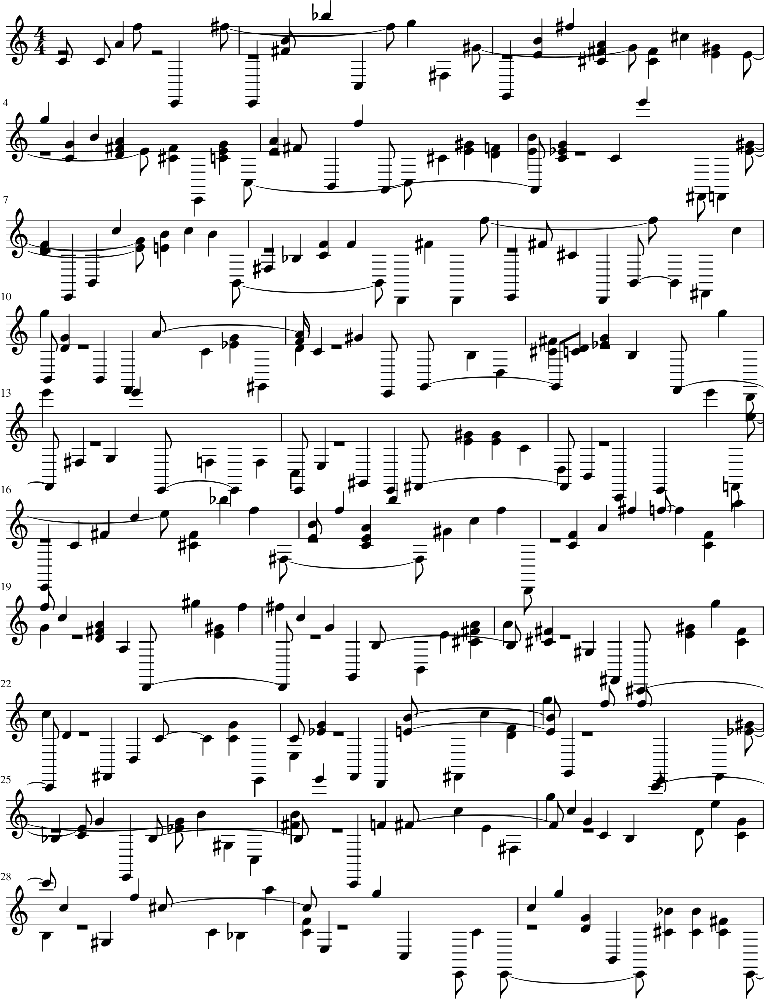

TypeError: 'NoneType' object is not subscriptable

Time Signature Changes: 0 Instruments: 1


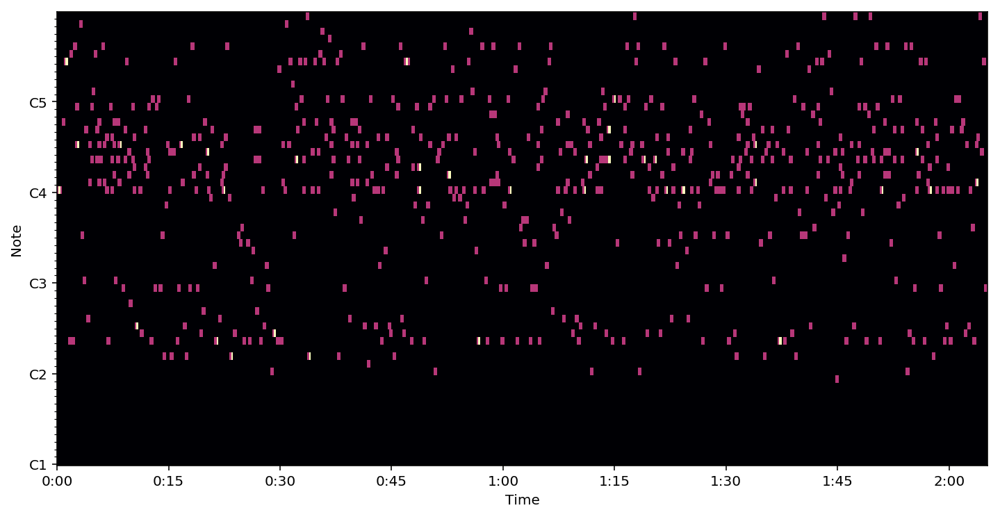

In [9]:
midi_file = '2_4L_201803290654-100-lstm_midi.mid'
instrument_dict,pm = analyze_midi(midi_file)
convert_midi_to_notestream(midi_file)
ipd.Audio(pm.synthesize(fs=fs), rate=rate)

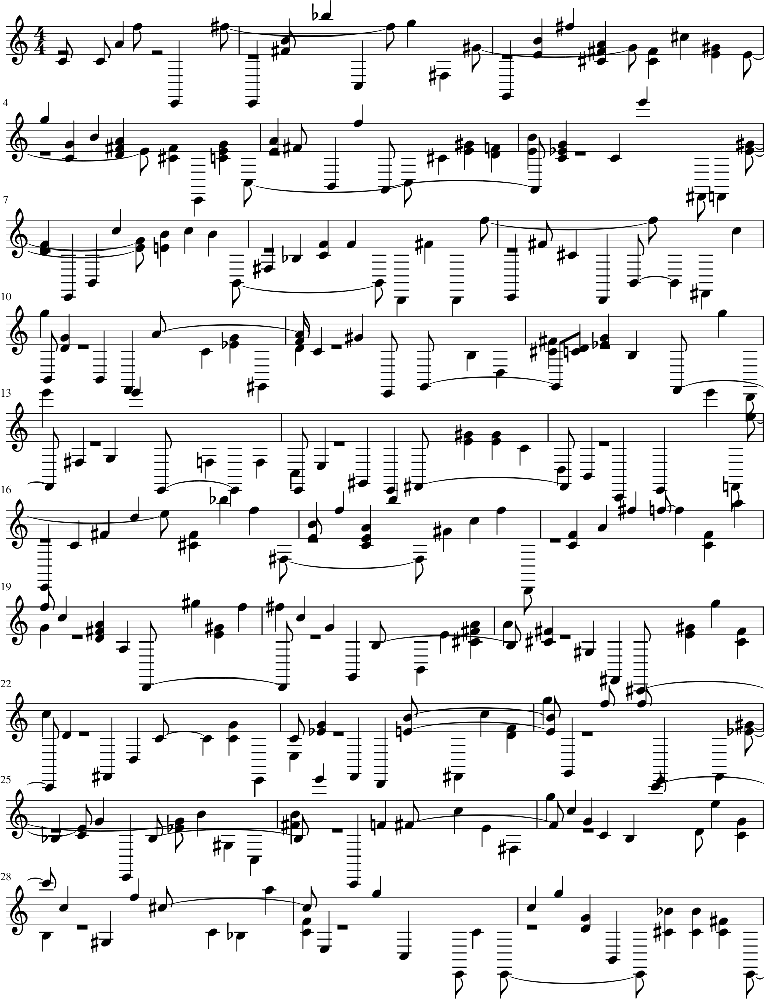

Time Signature Changes: 4 Instruments: 3


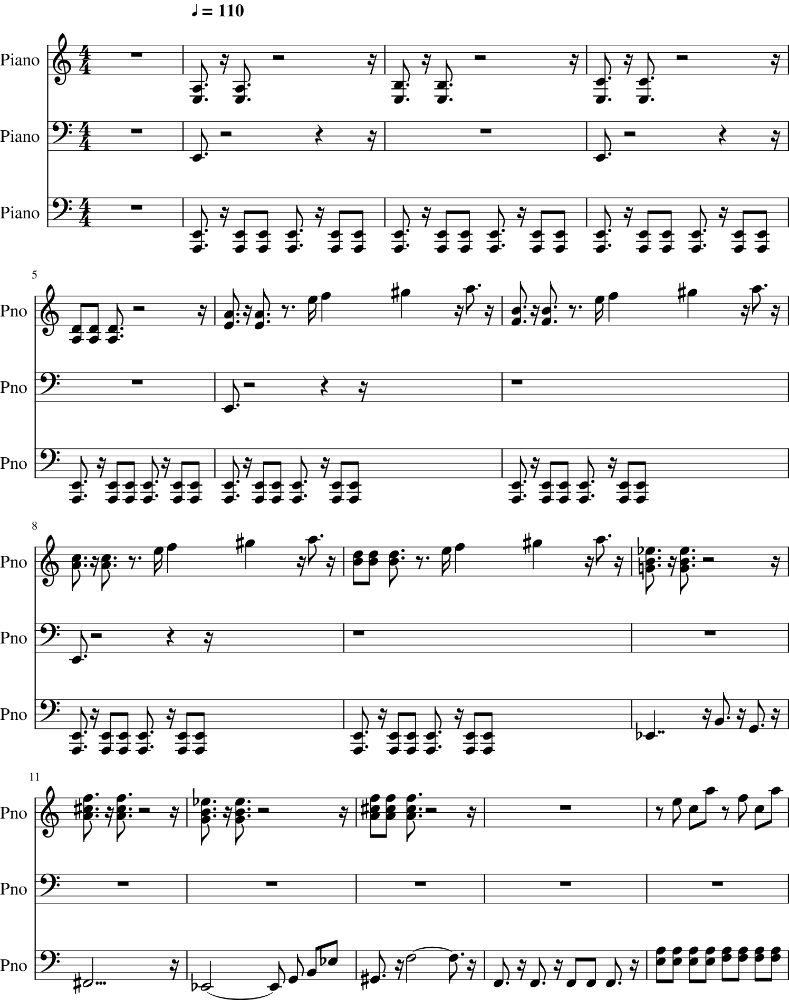

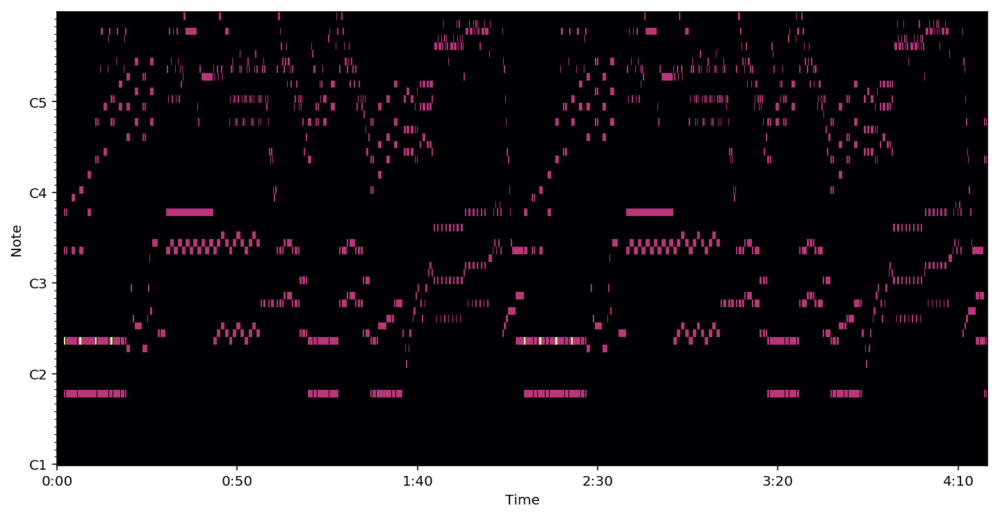

In [22]:
midi_file = '/media/cipher000/DATA/Dropbox/Programming/BootCamps/Metis/00Bootcamp/McMahon_Metis/Project_5/data/Music/FinalFantasy/0fithos.mid'
instrument_dict,pm = analyze_midi(midi_file)
convert_midi_to_notestream(midi_file)
ipd.Audio(pm.synthesize(fs=fs), rate=rate)